In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from sklearn import metrics

from statsmodels.graphics.tsaplots import plot_pacf
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.stats.diagnostic import acorr_ljungbox
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.stattools import acf
from statsmodels.stats.stattools import durbin_watson
import statsmodels.api as sm
from sklearn.metrics import mean_absolute_error

from scipy.stats import jarque_bera
from sklearn.metrics import r2_score
import warnings

from sklearn.metrics import mean_squared_error
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import boxcox


warnings.filterwarnings('ignore')
%matplotlib inline
# plt.style.use('fivethirtyeight')
plt.rcParams['figure.figsize'] = [20,8]


from pandas_profiling import ProfileReport
import statsmodels.tsa.api as smt
import statsmodels.api as sm
import scipy.stats as scs

# Reading time series 

In [2]:
df = pd.read_csv('../../data_dm/eduard/yahoo/BTC-USD.csv', header=0, index_col=0, parse_dates=True, dtype='float32')
# df = df 
y = pd.DataFrame(df['Close'])
df

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2016-04-10,419.592010,422.434998,419.256989,421.563995,421.563995,7.347860e+07
2016-04-11,421.872009,422.739014,420.532990,422.483002,422.483002,5.074750e+07
2016-04-12,422.842987,427.277008,422.842987,425.190002,425.190002,7.072880e+07
2016-04-13,425.631989,426.657990,422.915985,423.734009,423.734009,6.906040e+07
2016-04-14,423.934998,425.371002,423.013000,424.282013,424.282013,4.528100e+07
...,...,...,...,...,...,...
2021-04-04,57604.839844,58913.746094,57168.675781,58758.554688,58758.554688,5.074966e+10
2021-04-05,58760.875000,59891.296875,57694.824219,59057.878906,59057.878906,6.070627e+10
2021-04-06,59171.933594,59479.578125,57646.808594,58192.359375,58192.359375,6.605803e+10


In [3]:
from os import walk

input_directory = '../../data_dm/eduard/5_year_ago/'

def concate_data_from_qery(input_directory, resample=None):
    
    print(f'dir:\t{input_directory}')
    
    f = []
    for (dirpath, dirnames, filenames) in walk(input_directory):
        f.extend(filenames)
        break
        
    dFrames = []
    for file_name in f:
        
        data = pd.read_csv(f'{input_directory}/{file_name}', header=0, index_col=0, parse_dates=True, dtype='int8')
        data = data.drop(['isPartial'], axis=1)
        
        if resample is not None:
            data = data.resample(resample).mean()
            
        dFrames.append(data)
        
    result = pd.concat(dFrames, axis=1)
    
    return result

## Feature explanation without preparation

In [9]:
get_data = concate_data_from_qery(input_directory, resample=None)
get_data.info()

dir:	../../data_dm/eduard/5_year_ago/
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 261 entries, 2016-04-10 to 2021-04-04
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype
---  ------                   --------------  -----
 0   cryptocurrency bitcoin   261 non-null    int8 
 1   cryptocurrency exchange  261 non-null    int8 
 2   buy cryptocurrency       261 non-null    int8 
 3   cryptocurrency           261 non-null    int8 
 4   BTC-USD                  261 non-null    int8 
 5   Bitcoin Gold             261 non-null    int8 
 6   news cryptocurrency      261 non-null    int8 
 7   Bitcoin.com              261 non-null    int8 
 8   what is cryptocurrency   261 non-null    int8 
 9   Bitcoin Cash             261 non-null    int8 
 10  bitcoin price            261 non-null    int8 
 11  buy bitcoin              261 non-null    int8 
 12  best cryptocurrency      261 non-null    int8 
 13  binance                  261 non-null    int8 
 14  c

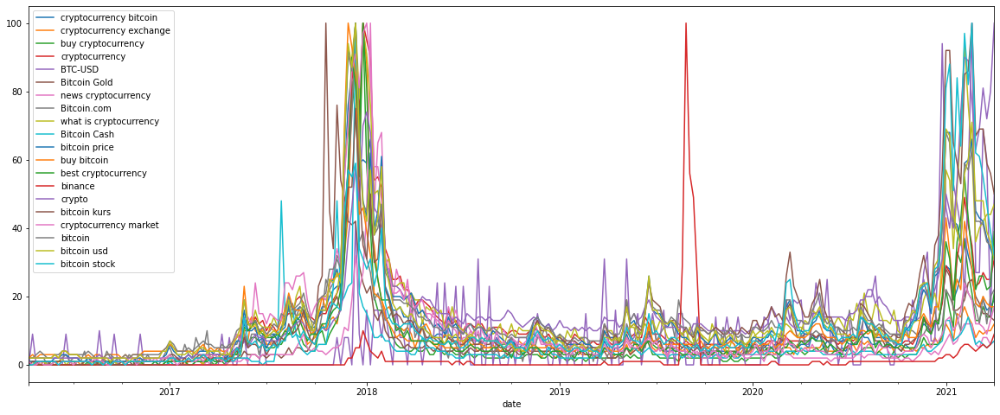

In [4]:
get_data.plot()

In [10]:
prof = ProfileReport(get_data, title='words_all_without_cleaning', explorative=True, progress_bar=True)
prof.to_notebook_iframe()

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [11]:
prof.to_file('../../data_dm/eduard/prepared_analysis/words_all_without_cleaning.html')

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

## Feature explanation with 'linear' extrapolation

In [4]:
get_data = concate_data_from_qery(input_directory, resample='D')
get_data.info()

dir:	../../data_dm/eduard/5_year_ago/
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1821 entries, 2016-04-10 to 2021-04-04
Freq: D
Data columns (total 20 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   cryptocurrency bitcoin   261 non-null    float64
 1   cryptocurrency exchange  261 non-null    float64
 2   buy cryptocurrency       261 non-null    float64
 3   cryptocurrency           261 non-null    float64
 4   BTC-USD                  261 non-null    float64
 5   Bitcoin Gold             261 non-null    float64
 6   news cryptocurrency      261 non-null    float64
 7   Bitcoin.com              261 non-null    float64
 8   what is cryptocurrency   261 non-null    float64
 9   Bitcoin Cash             261 non-null    float64
 10  bitcoin price            261 non-null    float64
 11  buy bitcoin              261 non-null    float64
 12  best cryptocurrency      261 non-null    float64
 13  binance       

In [5]:
get_data

,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,BTC-USD,Bitcoin Gold,news cryptocurrency,Bitcoin.com,what is cryptocurrency,Bitcoin Cash,bitcoin price,buy bitcoin,best cryptocurrency,binance,crypto,bitcoin kurs,cryptocurrency market,bitcoin,bitcoin usd,bitcoin stock
date,,,,,,,,,,,,,,,,,,,,
2016-04-10,1.0,1.0,0.0,1.0,0.0,0.0,0.0,2.0,1.0,0.0,1.0,2.0,0.0,0.0,2.0,0.0,1.0,2.0,2.0,0.0
2016-04-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-13,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-14,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-31,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-04-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2021-04-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Data analysis `linear` filling data

In [6]:
resulting_data = pd.concat([df, get_data], axis=1).astype('float32')
resulting_data_filled_linear = resulting_data.interpolate('linear')
resulting_data_filled_linear = resulting_data_filled_linear.astype('float32')

In [ ]:
%%time
prof = ProfileReport(resulting_data_filled_linear)

prof.to_notebook_iframe()
prof.to_file('../../data_dm/eduard/prepared_analysis/words_bitok_linear_filling_nan.html')

## Showing the time series data for Bitcoin

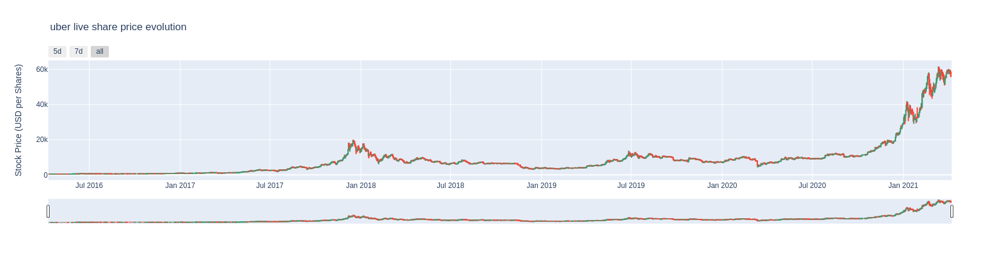

In [11]:
import plotly.graph_objs as go


data = df

fig = go.Figure()
fig.add_trace(go.Candlestick(x=data.index,
                             open=data['Open'],
                            high=data['High'],
                            low=data['Low'],
                            close=data['Close'], name = 'market data'))

fig.update_layout(title="uber live share price evolution",
                 yaxis_title='Stock Price (USD per Shares)')

fig.update_xaxes(rangeslider_visible=True,
                rangeselector=dict(
                    buttons=list([
                        dict(count=5, label='5d', step='day', stepmode='backward'),
                        dict(count=7, label='7d', step='day', stepmode='backward'),
#                         dict(count=1, label='HTD', step='hour', stepmode='todate'),
#                         dict(count=3, label='3h', step='hour', stepmode='backward'),
                        dict(step='all')
                    ])
                ))

fig.show()

# Next steps

In [19]:
droped_columns = ['binance', 'Volume', 'Adj Close', 'Low', 'High', 'Open']

resulting_df = resulting_data_filled_linear.drop(droped_columns, axis=1)
resulting_df

,Close,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,BTC-USD,Bitcoin Gold,news cryptocurrency,Bitcoin.com,what is cryptocurrency,Bitcoin Cash,bitcoin price,buy bitcoin,best cryptocurrency,crypto,bitcoin kurs,cryptocurrency market,bitcoin,bitcoin usd,bitcoin stock
2016-04-10,421.563995,1.0,1.000000,0.0,1.000000,0.000000,0.000000,0.0,2.0,1.0,0.0,1.0,2.000000,0.0,2.0,0.000000,1.000000,2.0,2.0,0.0
2016-04-11,422.483002,1.0,0.857143,0.0,0.857143,1.285714,0.142857,0.0,2.0,1.0,0.0,1.0,2.142857,0.0,2.0,0.142857,0.857143,2.0,2.0,0.0
2016-04-12,425.190002,1.0,0.714286,0.0,0.714286,2.571429,0.285714,0.0,2.0,1.0,0.0,1.0,2.285714,0.0,2.0,0.285714,0.714286,2.0,2.0,0.0
2016-04-13,423.734009,1.0,0.571429,0.0,0.571429,3.857143,0.428571,0.0,2.0,1.0,0.0,1.0,2.428571,0.0,2.0,0.428571,0.571429,2.0,2.0,0.0
2016-04-14,424.282013,1.0,0.428571,0.0,0.428571,5.142857,0.571429,0.0,2.0,1.0,0.0,1.0,2.571429,0.0,2.0,0.571429,0.428571,2.0,2.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-04,58758.554688,19.0,12.000000,21.0,31.000000,50.000000,13.000000,7.0,22.0,47.0,7.0,31.0,17.000000,39.0,100.0,50.000000,17.000000,32.0,31.0,32.0
2021-04-05,59057.878906,19.0,12.000000,21.0,31.000000,50.000000,13.000000,7.0,22.0,47.0,7.0,31.0,17.000000,39.0,100.0,50.000000,17.000000,32.0,31.0,32.0
2021-04-06,58192.359375,19.0,12.000000,21.0,31.000000,50.000000,13.000000,7.0,22.0,47.0,7.0,31.0,17.000000,39.0,100.0,50.000000,17.000000,32.0,31.0,32.0
2021-04-07,56048.937500,19.0,12.000000,21.0,31.000000,50.000000,13.000000,7.0,22.0,47.0,7.0,31.0,17.000000,39.0,100.0,50.000000,17.000000,32.0,31.0,32.0


In [50]:
def tsplot(y, lags=None, figsize=(15, 13), style='bmh',title=''):
    if not isinstance(y, pd.Series):
        y = pd.Series(y)
    with plt.style.context(style):    
        fig = plt.figure(figsize=figsize)
        #mpl.rcParams['font.family'] = 'Ubuntu Mono'
        layout = (3, 2)
        ts_ax = plt.subplot2grid(layout, (0, 0), colspan=2)
        acf_ax = plt.subplot2grid(layout, (1, 0))
        pacf_ax = plt.subplot2grid(layout, (1, 1))
        qq_ax = plt.subplot2grid(layout, (2, 0))
        pp_ax = plt.subplot2grid(layout, (2, 1))
        
        y.plot(ax=ts_ax)
        ts_ax.set_title(title)
        smt.graphics.plot_acf(y, lags=lags, ax=acf_ax, alpha=0.5)
        smt.graphics.plot_pacf(y, lags=lags, ax=pacf_ax, alpha=0.5)
        sm.qqplot(y, line='s', ax=qq_ax)
        qq_ax.set_title('QQ Plot')        
        scs.probplot(y, sparams=(y.mean(), y.std()), plot=pp_ax)

        plt.tight_layout()
    return 

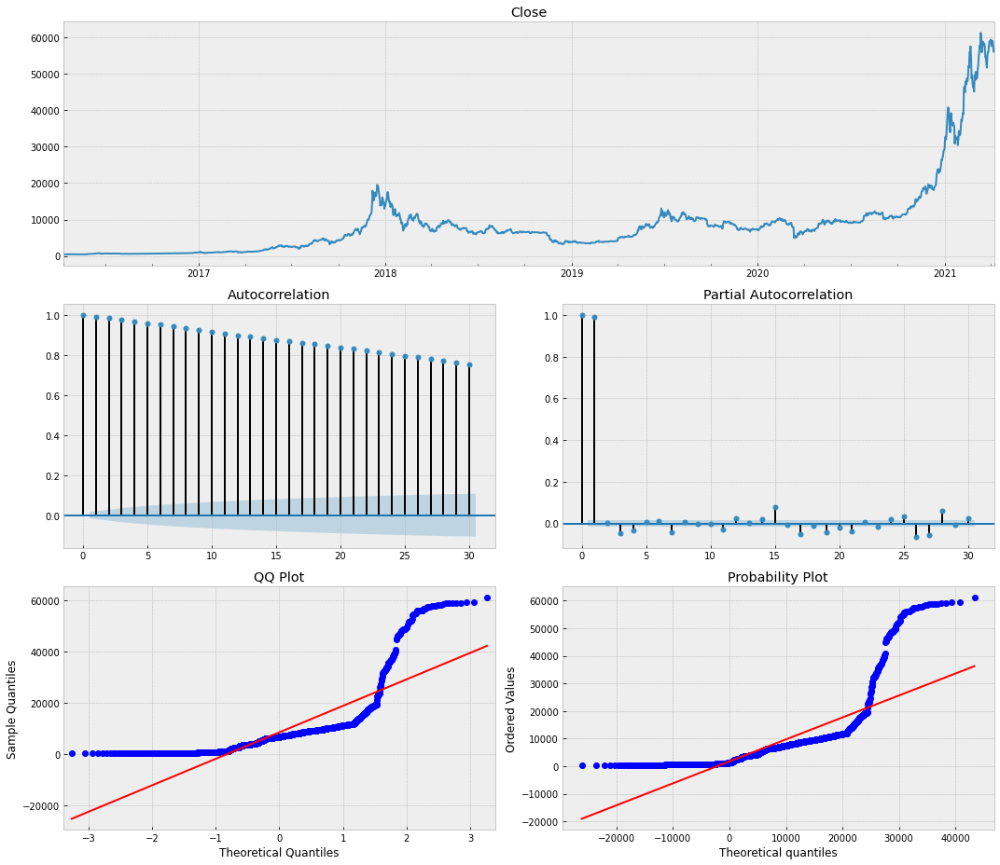

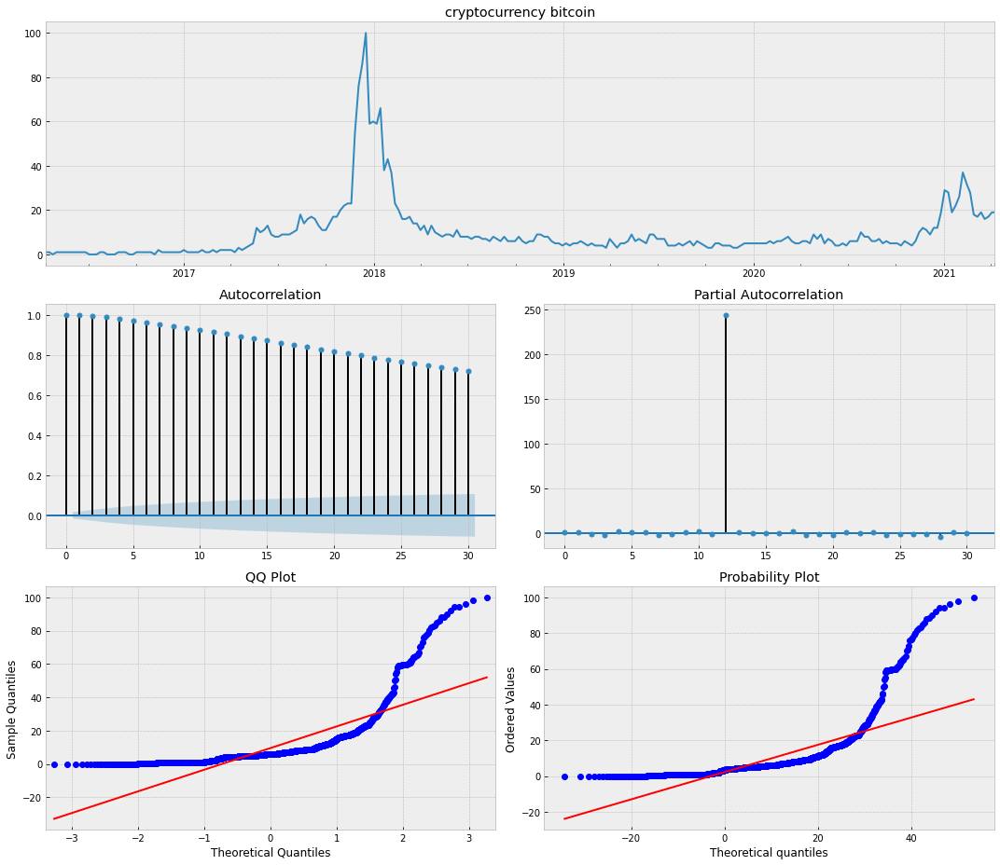

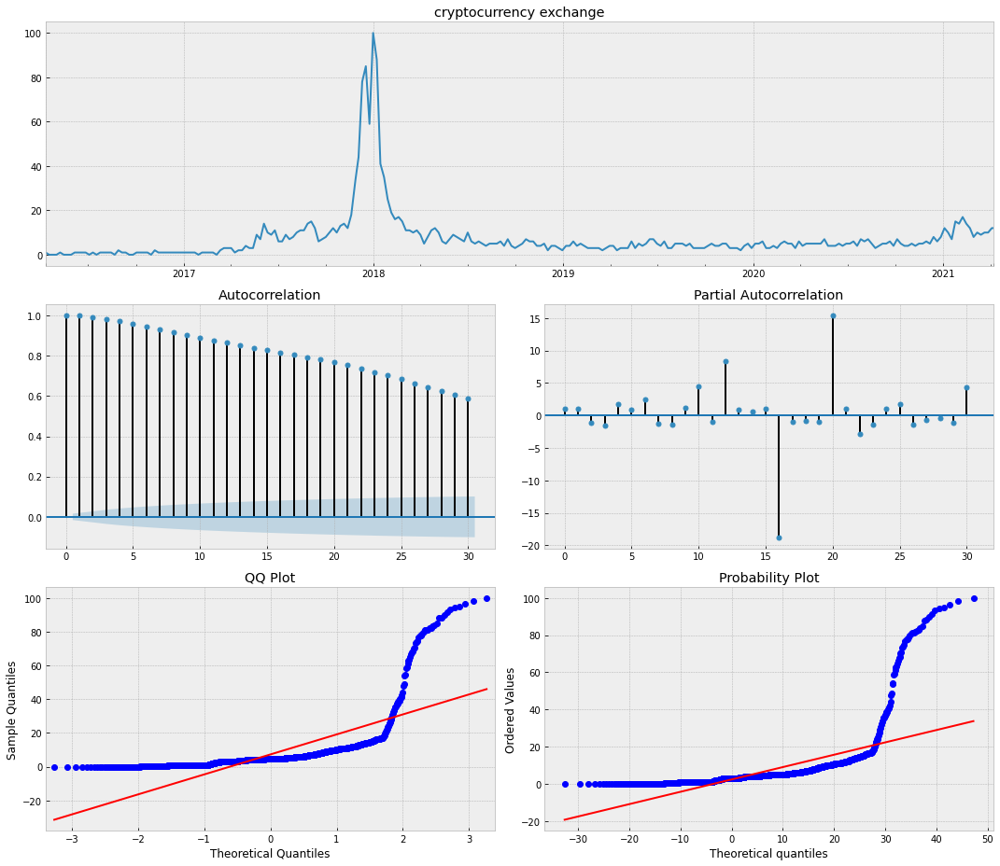

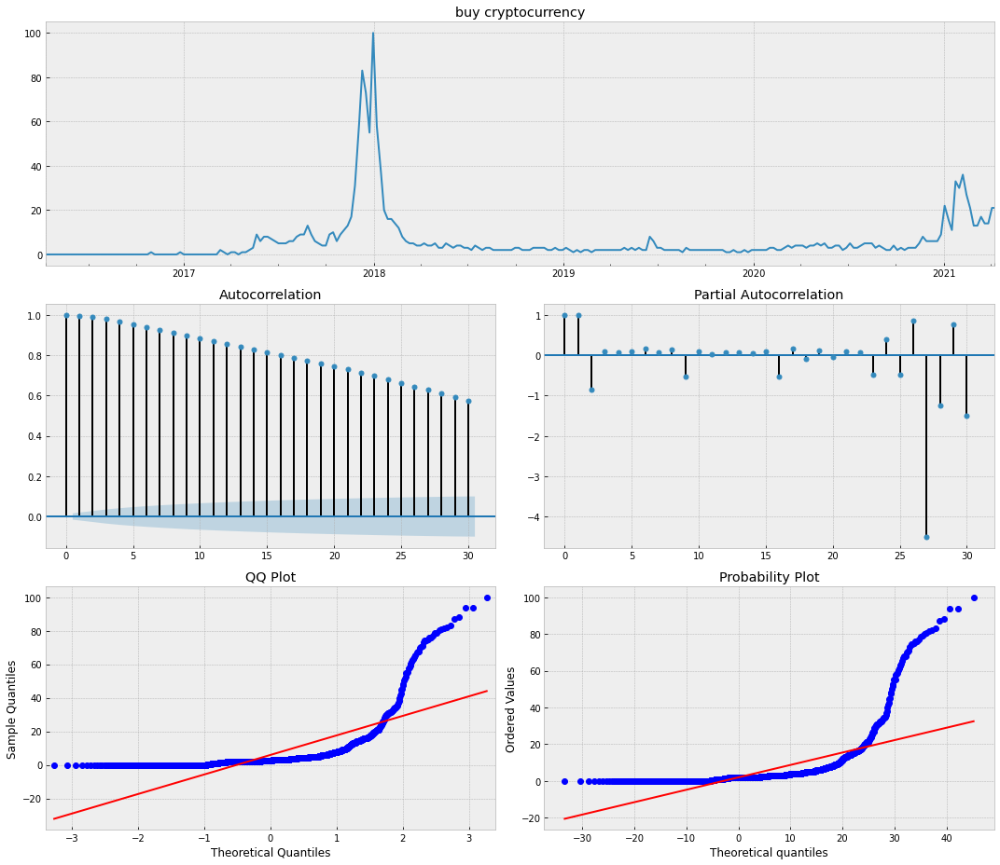

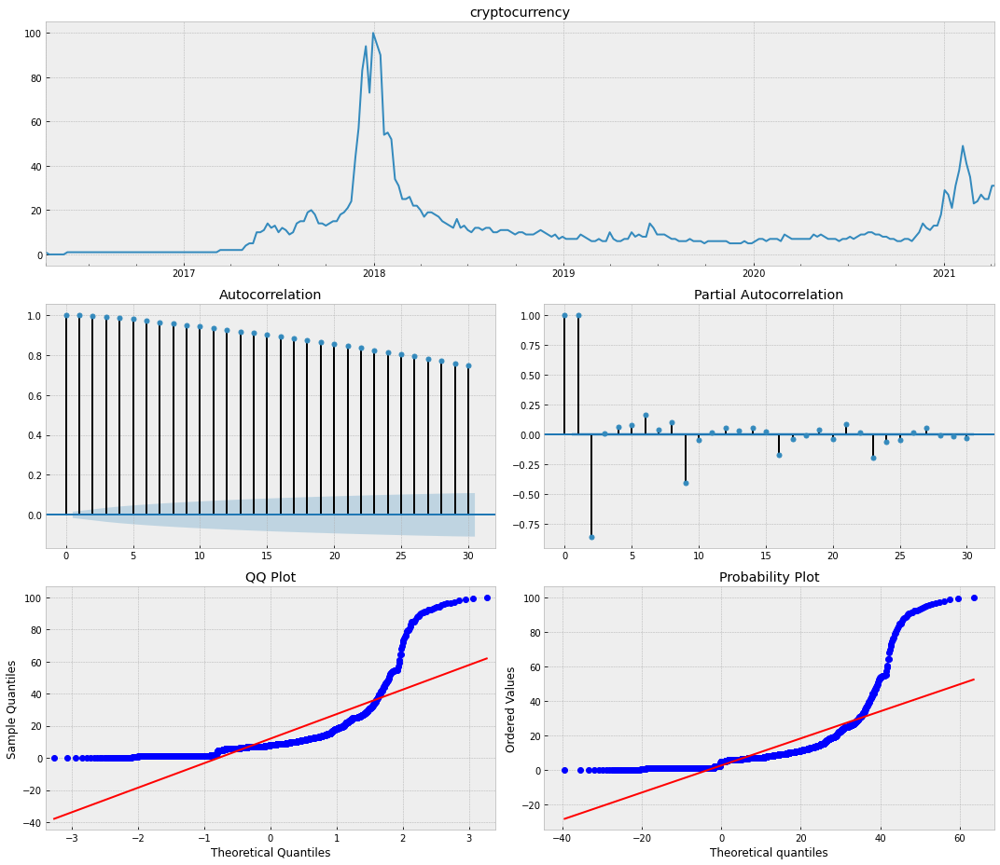

...

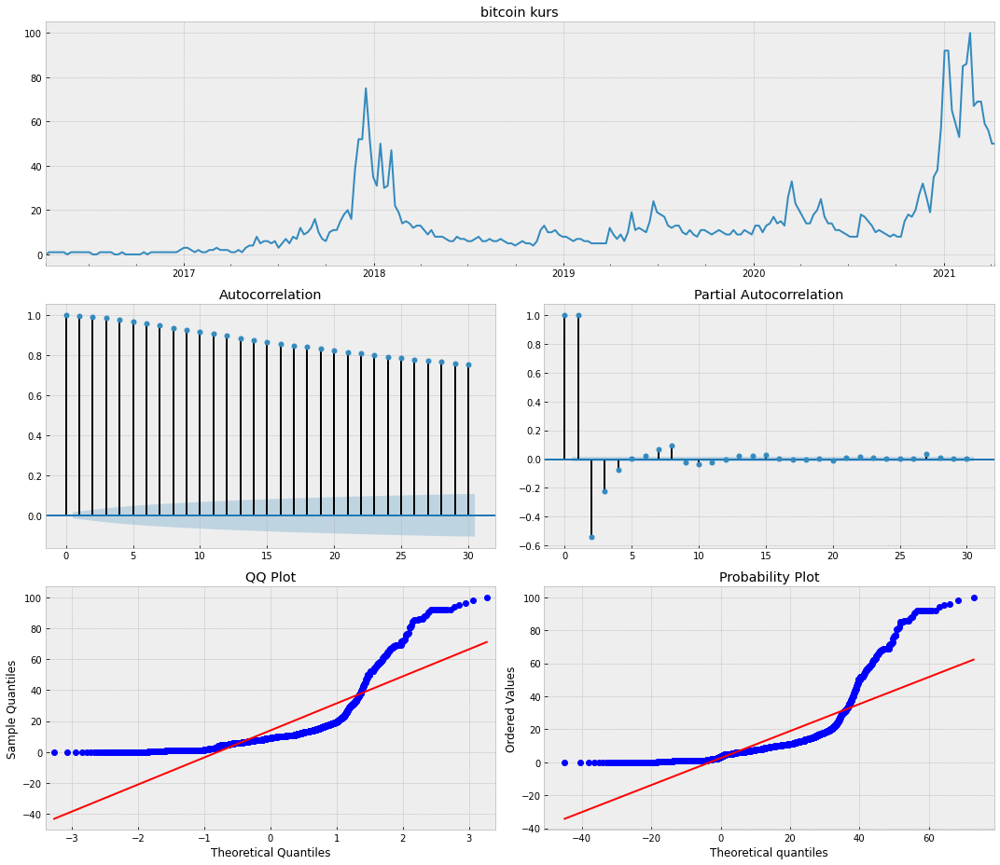

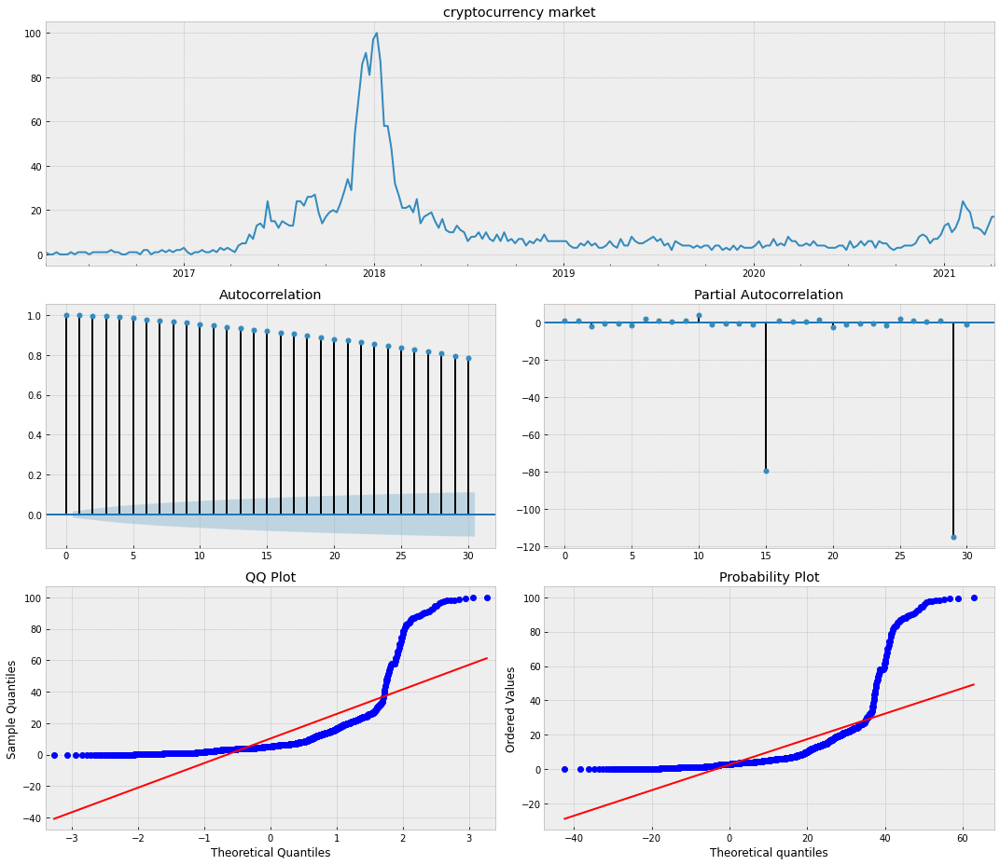

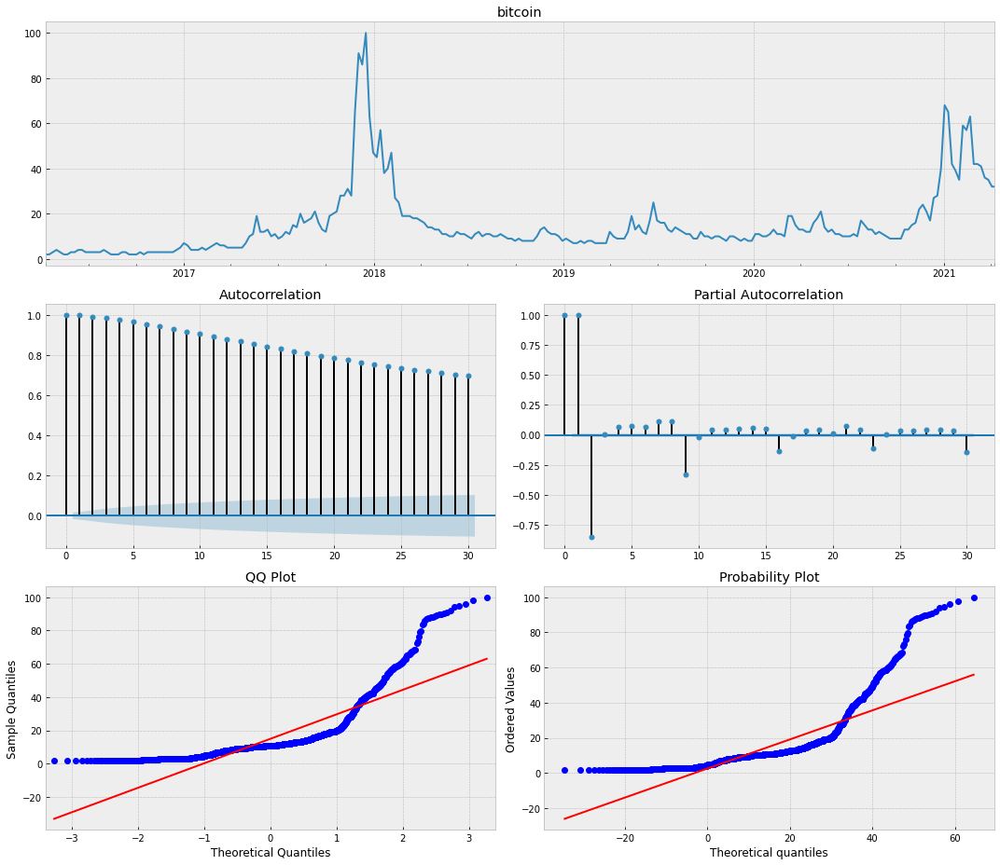

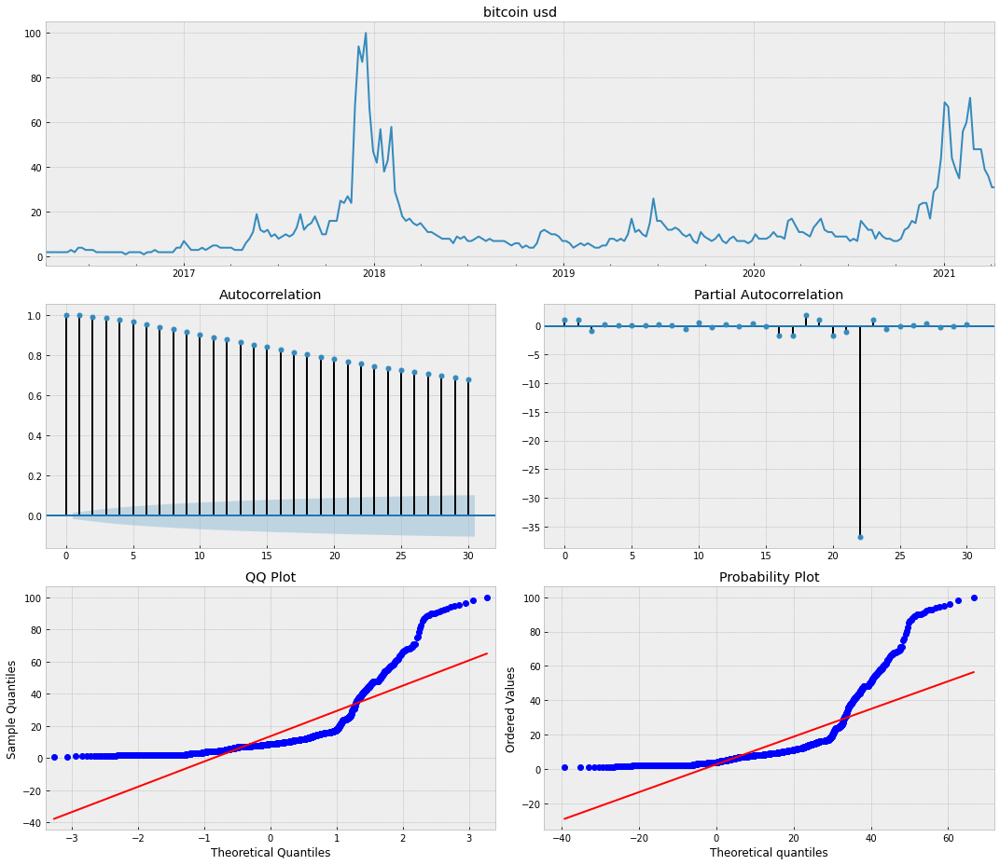

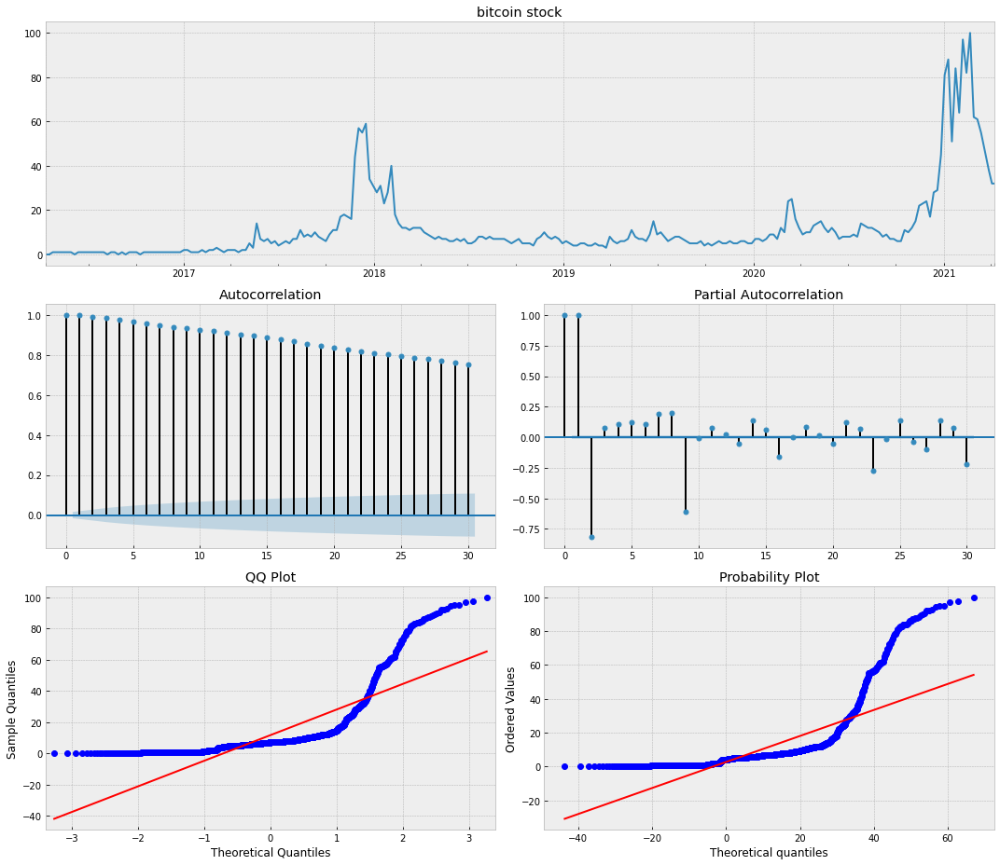

In [31]:
for column in resulting_df.columns:
#     plt.subplots(int(f'22{i}'))
    tsplot(resulting_df[column], lags=30,title=column)

## qq plots after box-cox 

In [63]:
from scipy.stats import boxcox

lmbds = []
columns_lmbds = resulting_df.columns.to_list()

# expliciti imputing zeros value as a const
resulting = resulting_df.copy()
resulting.iloc[:,:] = np.where(resulting ==0, 1e-1, resulting)

df_box = resulting.copy()

for column in columns_lmbds:
    print(f'column:\t{column}')
    data_box_cox, lmbd = boxcox(df_box[column][df_box[column] > 0])
    df_box[column] = np.power(df_box[column], lmbd)
    lmbds.append(lmbd)

lmbds

column:	Close
column:	cryptocurrency bitcoin
column:	cryptocurrency exchange
column:	buy cryptocurrency
column:	cryptocurrency
column:	BTC-USD
column:	Bitcoin Gold
column:	news cryptocurrency
column:	Bitcoin.com
column:	what is cryptocurrency
column:	Bitcoin Cash
column:	bitcoin price
column:	buy bitcoin
column:	best cryptocurrency
column:	crypto
column:	bitcoin kurs
column:	cryptocurrency market
column:	bitcoin
column:	bitcoin usd
column:	bitcoin stock


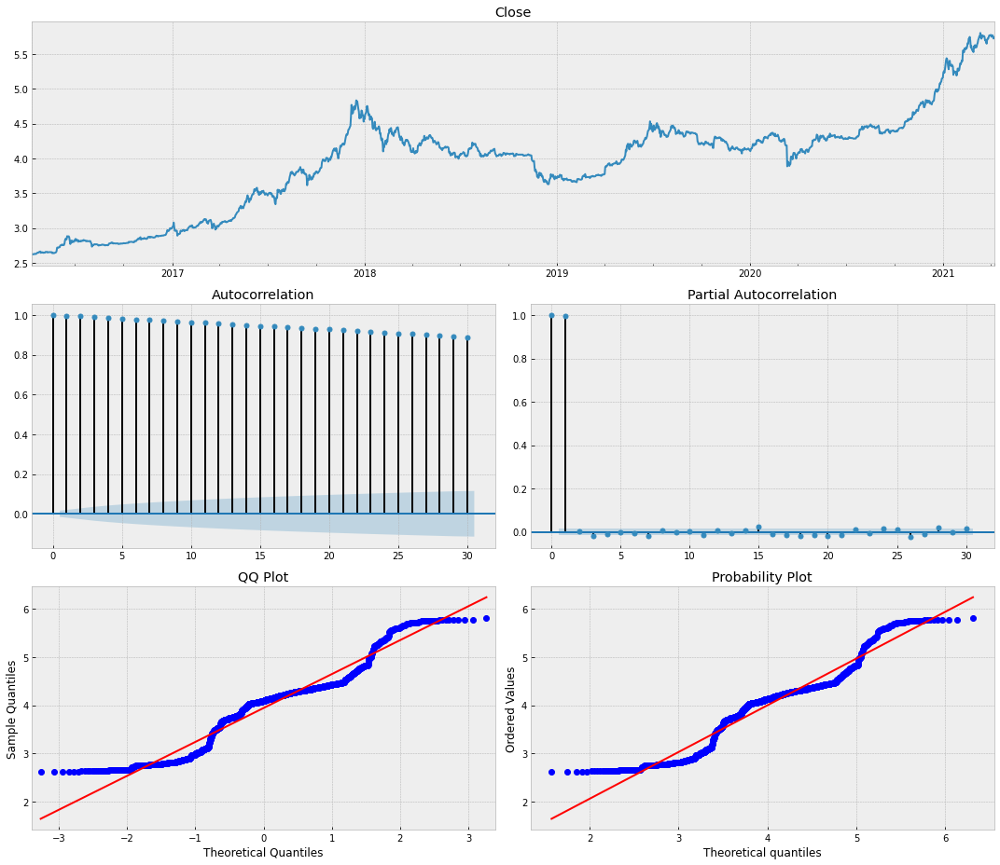

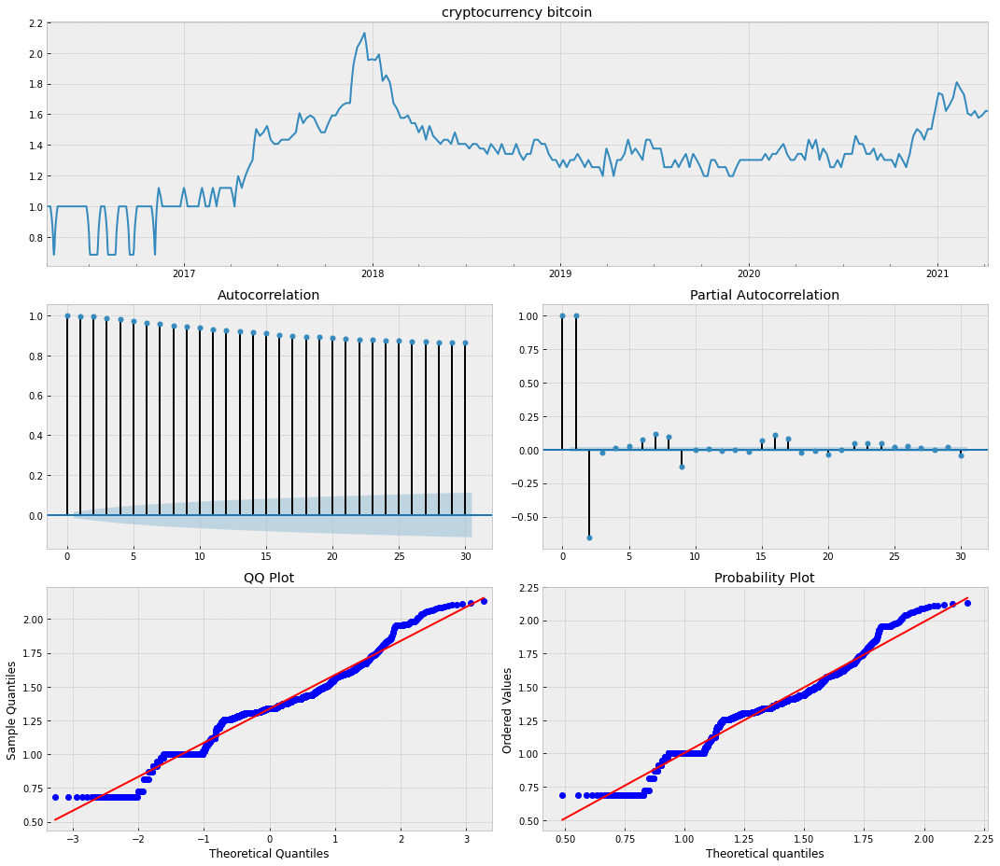

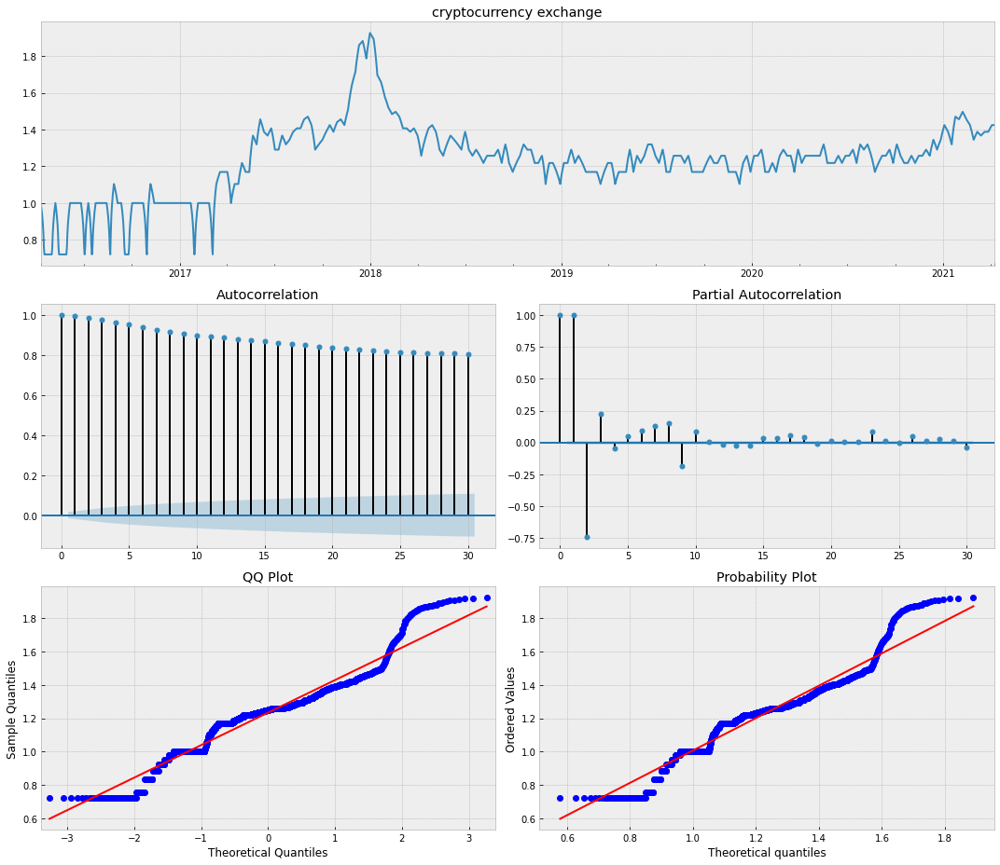

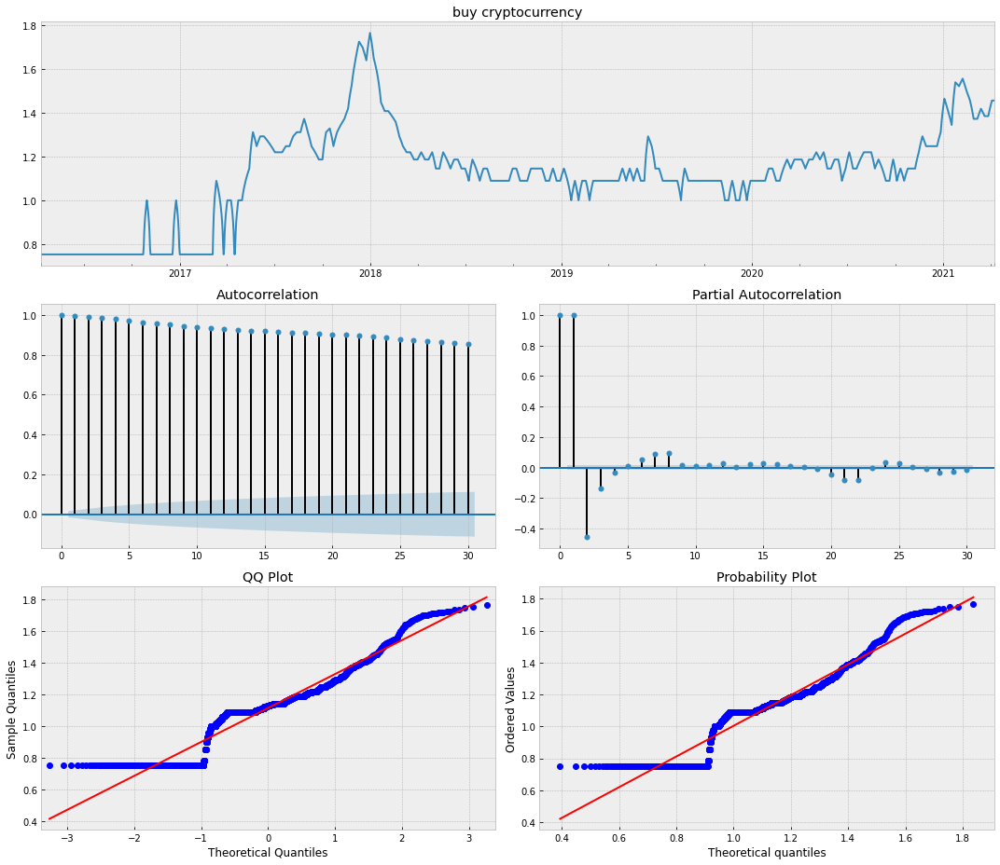

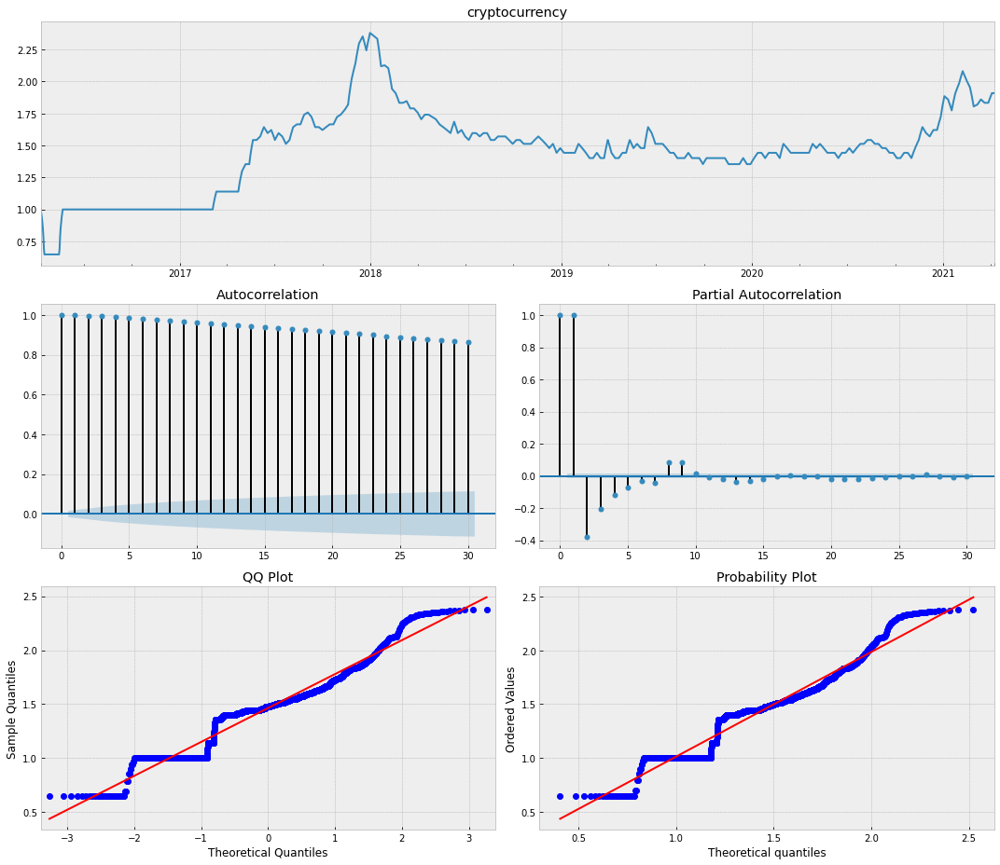

...

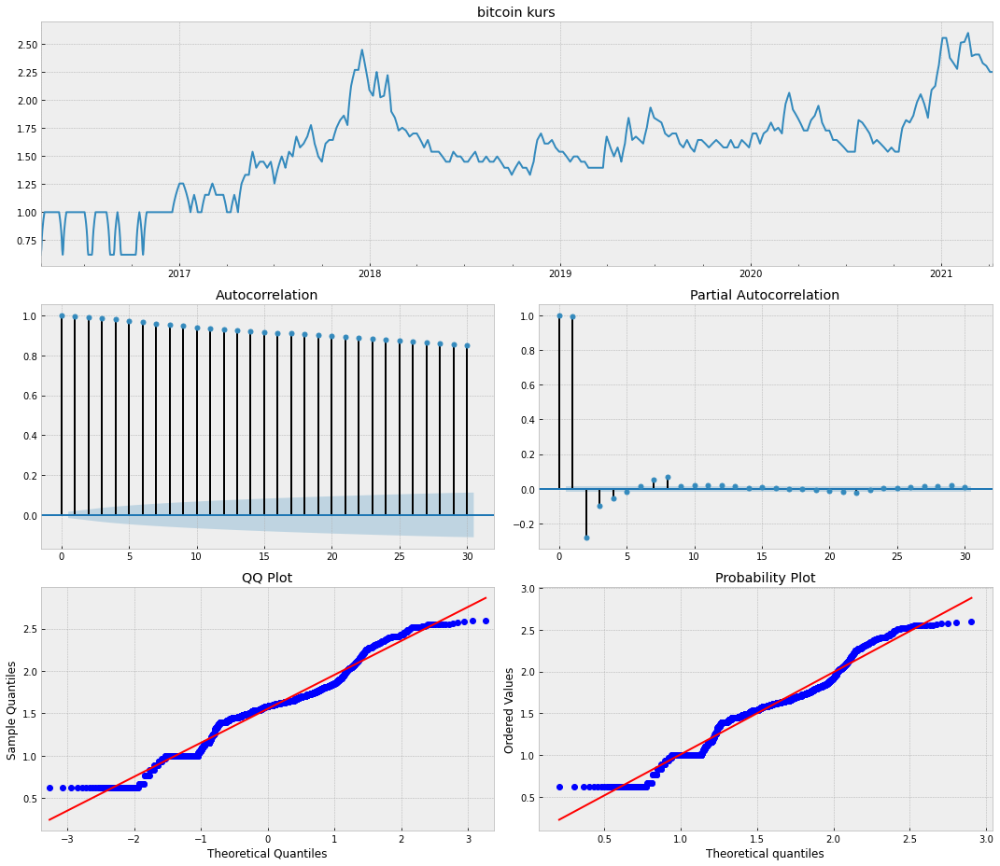

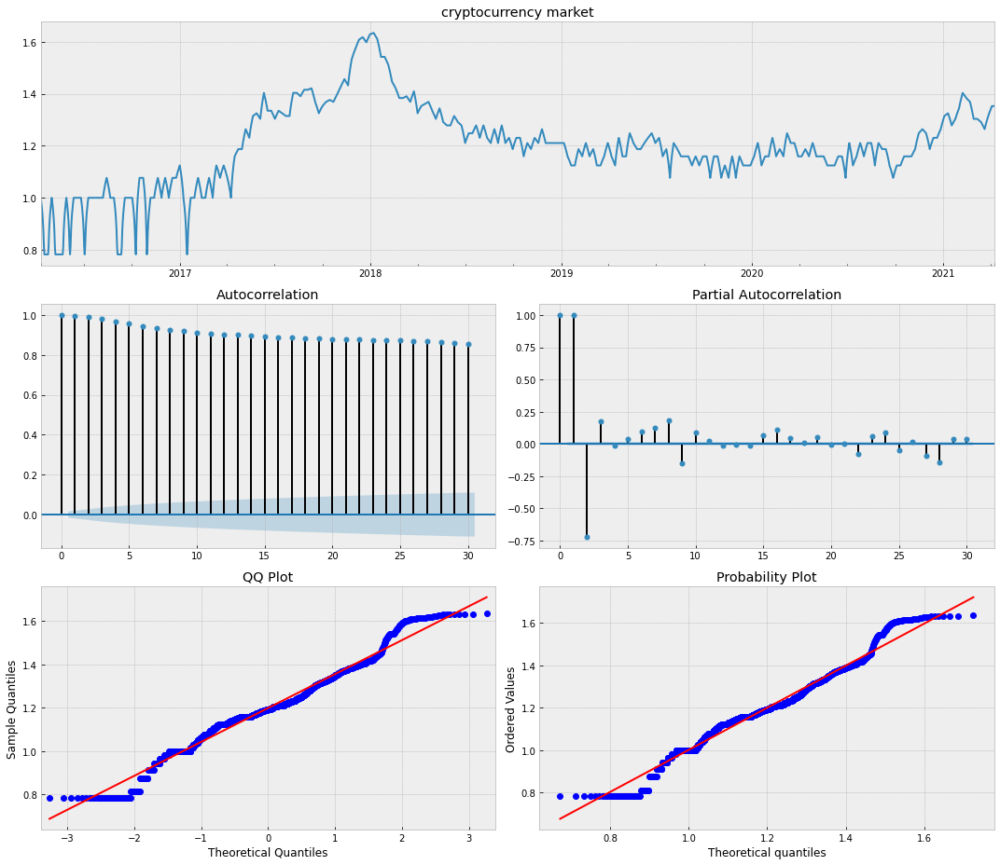

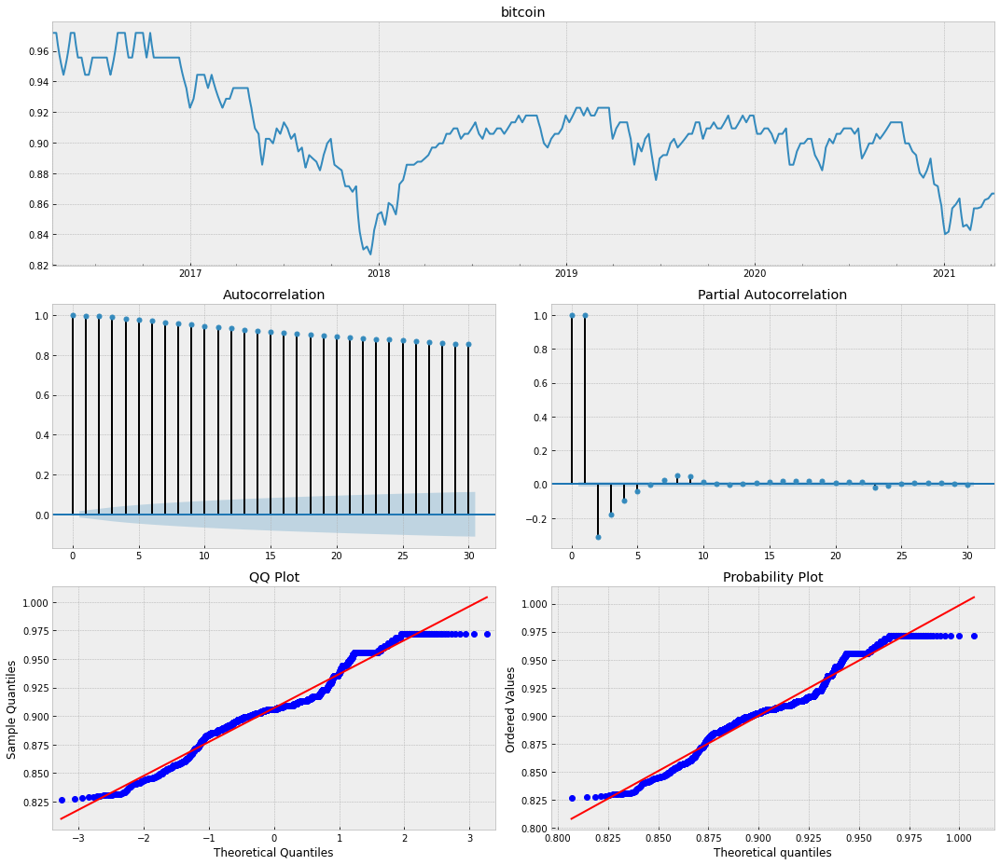

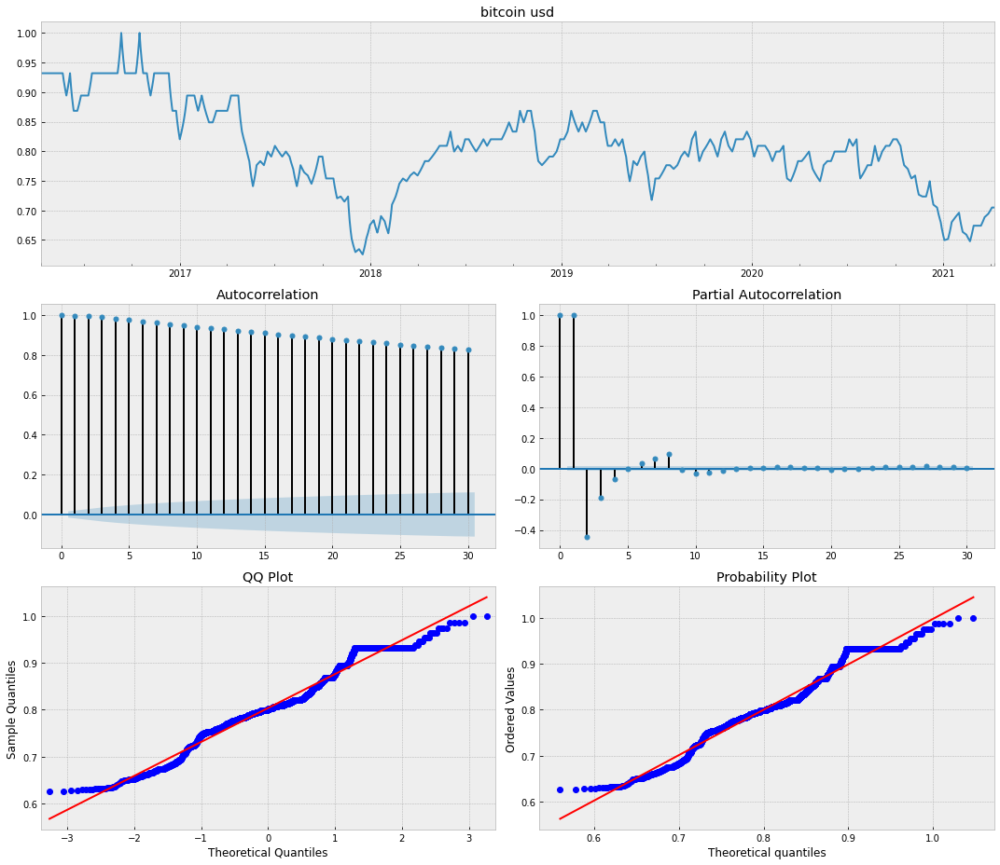

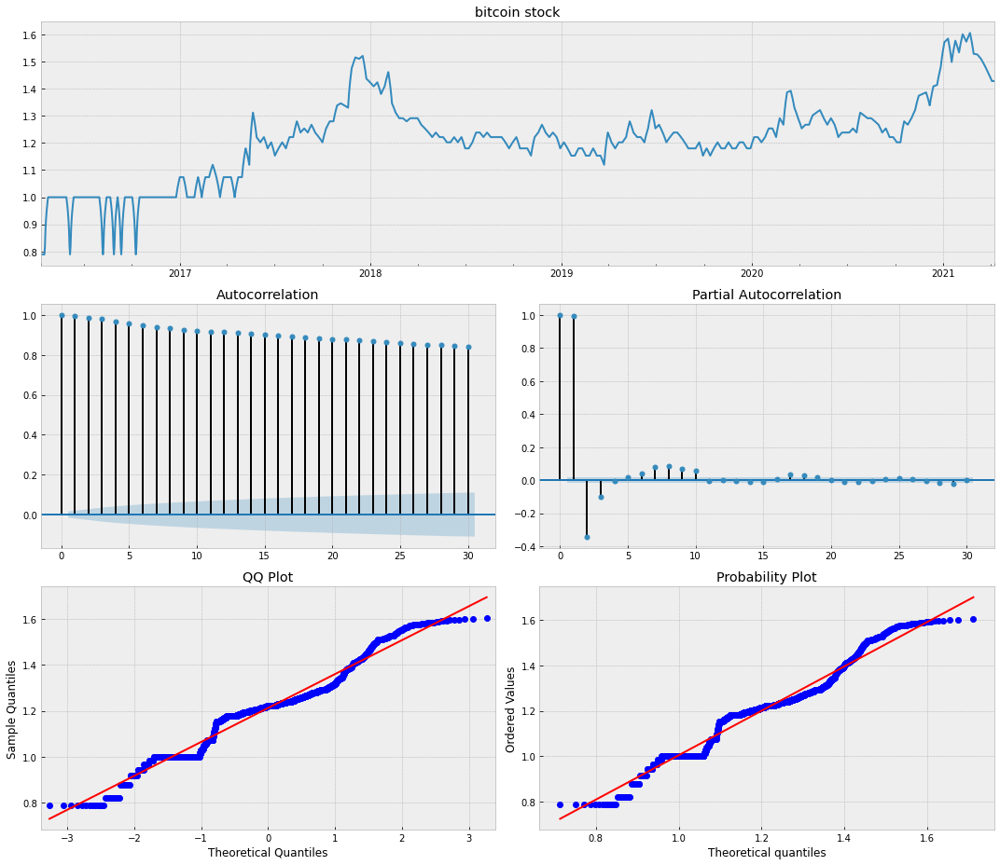

In [64]:
for column in df_box.columns:
#     plt.subplots(int(f'22{i}'))
    tsplot(df_box[column], lags=30,title=column)

## pipeline with feature engeenering

In [68]:
resulting_df.head()

,Close,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,BTC-USD,Bitcoin Gold,news cryptocurrency,Bitcoin.com,what is cryptocurrency,Bitcoin Cash,bitcoin price,buy bitcoin,best cryptocurrency,crypto,bitcoin kurs,cryptocurrency market,bitcoin,bitcoin usd,bitcoin stock
2016-04-10,421.563995,1.0,1.000000,0.0,1.000000,0.000000,0.000000,0.0,2.0,1.0,0.0,1.0,2.000000,0.0,2.0,0.000000,1.000000,2.0,2.0,0.0
2016-04-11,422.483002,1.0,0.857143,0.0,0.857143,1.285714,0.142857,0.0,2.0,1.0,0.0,1.0,2.142857,0.0,2.0,0.142857,0.857143,2.0,2.0,0.0
2016-04-12,425.190002,1.0,0.714286,0.0,0.714286,2.571429,0.285714,0.0,2.0,1.0,0.0,1.0,2.285714,0.0,2.0,0.285714,0.714286,2.0,2.0,0.0
2016-04-13,423.734009,1.0,0.571429,0.0,0.571429,3.857143,0.428571,0.0,2.0,1.0,0.0,1.0,2.428571,0.0,2.0,0.428571,0.571429,2.0,2.0,0.0
2016-04-14,424.282013,1.0,0.428571,0.0,0.428571,5.142857,0.571429,0.0,2.0,1.0,0.0,1.0,2.571429,0.0,2.0,0.571429,0.428571,2.0,2.0,0.0


In [13]:
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, RegressorMixin, TransformerMixin, clone
from sklearn.preprocessing import PolynomialFeatures
import seaborn as sns

# def barplot(data, title):
# #     fig = plt.figure(figsize=(18,6))
#     bar_plot = sns.barplot(x=data['feature'], y=data['value'])
#     for item in bar_plot.get_xticklabels():
#         item.set_rotation(90)
#     plt.title(title)
#     plt.show()

class Interpolation(BaseEstimator, TransformerMixin):
    def __init__(self, kind_of_interpolation='linear', astype='float32'):
        self.kind_of_interpolation = kind_of_interpolation
        self.astype = astype
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
        X_copy = resulting_data.interpolate(self.kind_of_interpolation).astype(self.astype)
        
        return X_copy

class TranformTimeSeries(BaseEstimator, TransformerMixin):
    
    def __init__(self, box_cox=[]): #, diff_model=dict()):
#         self.diff_model = diff_model
        self.box_cox = box_cox
        
    def fit(self, X, y=None):
        
        if len(self.box_cox) == 0:
            return self
        
        lmbds = []
        columns_lmbds = self.box_cox.copy()

        # expliciti imputing zeros value as a const
        resulting = X.copy()
        resulting[columns_lmbds] = np.where(resulting[columns_lmbds] == 0, 1e-1, resulting[columns_lmbds])

        df_box = resulting.copy()

        for column in columns_lmbds:
            print(f'column:\t{column}')
            data_box_cox, lmbd = boxcox(df_box[column])
            df_box[column] = np.power(df_box[column], lmbd)
            lmbds.append(lmbd)
            
        self.lmbds = dict((col, lmbd) for col, lmbd in zip(columns_lmbds, lmbds))
        
        return self

    def transform(self, X, y=None):
        
        resulting = X.copy()
        resulting[self.box_cox] = np.where(resulting[self.box_cox] == 0, 1e-1, resulting[self.box_cox])

        df_box = resulting.copy()

        for column, lmbd in self.lmbds.items():
#             print(f'column:\t{column}')
            data_box_cox = boxcox(df_box[column], lmbda=lmbd)
            df_box[column] = np.power(df_box[column], lmbd)
        
        return df_box

class Lags(BaseEstimator, TransformerMixin):
    def __init__(self, lags=0,columns=[]):
        self.lags = lags
        self.columns = columns
        
    def fit(self, X, y=None):
        
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
        
        transformed = pd.DataFrame()
        
        # creates lags for all features
        for i in range(1, self.lags + 1):
            col_my_new = list(x + '-1' for x in self.columns)
            transformed[col_my_new] = X_copy[self.columns].shift(i)
        
        
        result = pd.concat([X_copy, transformed], axis=1)
        return result.dropna()
    
    
class RollingMeanAverage(BaseEstimator, TransformerMixin):
    def __init__(self, window=2, columns=[]):
        self.window = window
        self.columns = columns
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
                
        transformed = pd.DataFrame()
        
        #creates rolling mean and std
        for i in range(2, self.window + 1):
            col_mean = list(x + f'_av_mean_{i}' for x in self.columns)

            transformed[col_mean] = X_copy[self.columns].rolling(window=i).mean()
        
        result = pd.concat([X_copy, transformed], axis=1)
        return result.dropna()
    
class RollingStdAverage(BaseEstimator, TransformerMixin):
    def __init__(self, window=2, columns=[]):
        self.window = window
        self.columns = columns

    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
                
        transformed = pd.DataFrame()
        
        #creates rolling mean and std
        for i in range(2, self.window + 1):
            col_std = list(x + f'_av_std_{i}' for x in self.columns)
            transformed[col_std] = X_copy[self.columns].rolling(window=i).std()
        
        result = pd.concat([X_copy, transformed], axis=1)
        return result.dropna()


class RollingMeanExponential(BaseEstimator, TransformerMixin):
    def __init__(self, window=2, com=0.8, columns=[]):
        self.window = window
        self.com=com
        self.columns = columns
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
                
        transformed = pd.DataFrame()
        
        #creates rolling mean and std
        for i in range(2, self.window + 1):
            col_mean = list(x + f'_ewm_mean_{i}' for x in self.columns)
            transformed[col_mean] = X_copy[self.columns].ewm(com=self.com).mean()
        
        result = pd.concat([X_copy, transformed], axis=1)
        return result.dropna()
    
class RollingStdExponential(BaseEstimator, TransformerMixin):
    def __init__(self, window=2, com=0.8,columns=[]):
        self.window = window
        self.com = com
        self.columns = columns
        
    def fit(self, X, y=None):
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
                
        transformed = pd.DataFrame()
        
        #creates rolling mean and std
        for i in range(2, self.window + 1):
            col_std = list(x + f'_ewn_std_{i}' for x in self.columns)
            transformed[col_std] = X_copy[self.columns].ewm(com=self.com).std()
        
        result = pd.concat([X_copy, transformed], axis=1)
        return result.dropna()

    
from featuretools.primitives import Week, Weekday, Year, Month
class DayWeekYear(BaseEstimator, TransformerMixin):
    def __init__(self, weak=True, month=True, year=True, weekday=True):
        self.weak_bool = weak
        self.month_bool = month
        self.year_bool = year
        self.weekday_bool = weekday
        
    def fit(self, X, y=None):
        if self.weak_bool:
            self.weak = Week()
        
        if self.month_bool:
            self.month = Month()
            
        if self.year_bool:
            self.year = Year()
        
        if self.weekday_bool:
            self.weekday = Weekday()
        
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
                
        transformed = pd.DataFrame()
        
        dates = X_copy.index
        
        if self.weak_bool:
            X_copy['weak'] = self.weak(dates).tolist()
            
        if self.month_bool:
            X_copy['month'] = self.month(dates).tolist()
            
        if self.year_bool:
            X_copy['year'] = self.year(dates).tolist()
        
        if self.weekday_bool:
            X_copy['weekDay'] = self.weekday(dates).tolist()
        
        return X_copy
    
    
class DinamicsForTimeSeries(BaseEstimator, TransformerMixin):
    def __init__(self, columns=[], dropna=True):
        self.columns = columns
        self.dropna = dropna
        
    def fit(self, X, y=None):
        X_copy = X.copy()
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
        X_shift = X_copy[self.columns].shift(1)
        X_dim = X_copy[self.columns] / X_shift
        new_columns = list(x + '_dinamic' for x in self.columns)
        X_dim.columns = new_columns
        
        X_with_dinamic = pd.concat([X_copy, X_dim], axis=1)
        
        if self.dropna:
            X_with_dinamic = X_with_dinamic.dropna()
            
        return X_with_dinamic

In [8]:
resulting_data.head()

,Open,High,Low,Close,Adj Close,Volume,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,...,bitcoin price,buy bitcoin,best cryptocurrency,binance,crypto,bitcoin kurs,cryptocurrency market,bitcoin,bitcoin usd,bitcoin stock
2016-04-10,419.592010,422.434998,419.256989,421.563995,421.563995,73478600.0,1.0,1.0,0.0,1.0,...,1.0,2.0,0.0,0.0,2.0,0.0,1.0,2.0,2.0,0.0
2016-04-11,421.872009,422.739014,420.532990,422.483002,422.483002,50747500.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-12,422.842987,427.277008,422.842987,425.190002,425.190002,70728800.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-13,425.631989,426.657990,422.915985,423.734009,423.734009,69060400.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-04-14,423.934998,425.371002,423.013000,424.282013,424.282013,45281000.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
class DinamicsForTimeSeries(BaseEstimator, TransformerMixin):
    def __init__(self, columns=[], dropna=True):
        self.columns = columns
        self.dropna = dropna
        
    def fit(self, X, y=None):
        X_copy = X.copy()
        return self
    
    def transform(self, X, y=None):
        X_copy = X.copy()
        X_shift = X_copy[self.columns].shift(1)
        X_dim = X_copy[self.columns] / X_shift
        new_columns = list(x + '_din' for x in self.columns)
        X_dim.columns = new_columns
        
        X_with_dinamic = pd.concat([X_copy, X_dim], axis=1)
        
        if self.dropna:
            X_with_dinamic = X_with_dinamic.dropna()
            
        return X_with_dinamic

In [17]:
inter = DinamicsForTimeSeries(columns=['Close'])
inter.fit(resulting_data)
tr = inter.transform(resulting_data)
tr

,Open,High,Low,Close,Adj Close,Volume,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,...,buy bitcoin,best cryptocurrency,binance,crypto,bitcoin kurs,cryptocurrency market,bitcoin,bitcoin usd,bitcoin stock,Close_din
2016-04-17,430.635986,431.371002,426.079010,427.398987,427.398987,5.212590e+07,1.0,0.0,0.0,0.0,...,3.0,0.0,0.0,2.0,1.0,0.0,2.0,2.0,0.0,0.992631
2016-04-24,450.559998,460.145996,448.928009,458.554993,458.554993,6.819840e+07,0.0,0.0,0.0,0.0,...,2.0,0.0,0.0,2.0,1.0,0.0,3.0,2.0,1.0,1.018373
2016-05-01,448.484009,452.479004,447.927002,451.875000,451.875000,4.066010e+07,1.0,0.0,0.0,0.0,...,3.0,0.0,0.0,2.0,1.0,1.0,4.0,2.0,1.0,1.007934
2016-05-08,458.428986,459.416992,455.983002,458.548004,458.548004,4.031500e+07,1.0,1.0,0.0,0.0,...,3.0,0.0,0.0,2.0,1.0,0.0,3.0,2.0,1.0,1.000026
2016-05-15,455.759003,458.691986,455.459015,457.567993,457.567993,2.851400e+07,1.0,0.0,0.0,0.0,...,3.0,0.0,0.0,2.0,1.0,0.0,2.0,2.0,1.0,1.004163
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-03-07,48918.679688,51384.367188,48918.679688,51206.691406,51206.691406,4.313746e+10,17.0,10.0,13.0,24.0,...,17.0,26.0,5.0,69.0,69.0,12.0,42.0,48.0,61.0,1.046906
2021-03-14,61221.132812,61597.917969,59302.316406,59302.316406,59302.316406,4.390123e+10,19.0,9.0,17.0,27.0,...,20.0,26.0,6.0,81.0,69.0,11.0,41.0,48.0,55.0,0.968310
2021-03-21,58309.914062,58767.898438,56005.617188,57523.421875,57523.421875,5.194342e+10,16.0,10.0,14.0,25.0,...,18.0,22.0,5.0,72.0,59.0,9.0,36.0,39.0,47.0,0.986449
2021-03-28,55974.941406,56610.312500,55071.113281,55950.746094,55950.746094,4.768658e+10,17.0,10.0,14.0,25.0,...,17.0,23.0,6.0,80.0,56.0,13.0,35.0,36.0,39.0,0.999593


In [19]:
columns_results = resulting_data.columns.to_list()

columns_TranformTimeSeries = ['Close']
columns_Lags = columns_results
columns_RollingMeanAverage = columns_results
columns_RollingStdAverage = columns_results
columns_RollingMeanExponential = columns_results
columns_RollingStdExponential = columns_results
columns_DinamicsForTimeSeries = ['Close']
lags = 4
com = 0.3
window = 7

pipeline = Pipeline([('Interpolation', Interpolation()),
    
                    ('TranformTimeSeries', TranformTimeSeries(box_cox=columns_TranformTimeSeries)),
                     
                    ('Lags',Lags(lags=lags, 
                                 columns=columns_Lags)),
                      
                    ('RollingMeanAverage', RollingMeanAverage(window=window,
                                                              columns=columns_RollingMeanAverage)),
                      
                    ('RollingStdAverage', RollingStdAverage(window=window, 
                                                            columns=columns_RollingStdAverage)),
                      
                    ('RollingMeanExponential', RollingMeanExponential(window=window, 
                                                                      columns=columns_RollingMeanExponential)),
                      
                    ('RollingStdExponential', RollingStdExponential(window=window, 
                                                                    columns=columns_RollingStdExponential)),
                    ('DayWeekYear', DayWeekYear()),
                    ('DinamicsForTimeSeries', DinamicsForTimeSeries(columns=columns_DinamicsForTimeSeries))])

pipeline.fit(resulting_data)
X_transformed = pipeline.transform(resulting_data)
X_transformed.head()

column:	Close


,Open,High,Low,Close,Adj Close,Volume,cryptocurrency bitcoin,cryptocurrency exchange,buy cryptocurrency,cryptocurrency,...,bitcoin kurs_ewn_std_7,cryptocurrency market_ewn_std_7,bitcoin_ewn_std_7,bitcoin usd_ewn_std_7,bitcoin stock_ewn_std_7,weak,month,year,weekDay,Close_din
2016-04-28,445.037994,449.550995,436.649994,2.648557,449.010986,7.406470e+07,0.571429,0.000000,0.0,0.0,...,0.000000,0.135978,0.135978,0.000000,0.000000,17,4,2016,3,1.001545
2016-04-29,449.407990,455.384003,446.016998,2.654250,455.096985,4.925850e+07,0.714286,0.000000,0.0,0.0,...,0.000000,0.163373,0.163373,0.000000,0.000000,17,4,2016,4,1.002150
2016-04-30,455.178009,455.587006,447.696991,2.647905,448.317993,6.932260e+07,0.857143,0.000000,0.0,0.0,...,0.000000,0.183322,0.183322,0.000000,0.000000,17,4,2016,5,0.997609
2016-05-01,448.484009,452.479004,447.927002,2.651244,451.875000,4.066010e+07,1.000000,0.000000,0.0,0.0,...,0.000000,0.196943,0.196943,0.000000,0.000000,17,5,2016,6,1.001261
2016-05-02,451.933014,452.445007,441.776001,2.644456,444.669006,9.212700e+07,1.000000,0.142857,0.0,0.0,...,0.000000,0.132555,0.132555,0.000000,0.000000,18,5,2016,0,0.997439
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-04-04,57604.839844,58913.746094,57168.675781,5.762630,58758.554688,5.074966e+10,19.000000,12.000000,21.0,31.0,...,1.301093,0.873999,0.649019,1.085853,1.533438,13,4,2021,6,1.003170
2021-04-05,58760.875000,59891.296875,57694.824219,5.767302,59057.878906,6.070627e+10,19.000000,12.000000,21.0,31.0,...,0.969740,0.650651,0.483904,0.809132,1.141106,14,4,2021,0,1.000811
2021-04-06,59171.933594,59479.578125,57646.808594,5.753737,58192.359375,6.605803e+10,19.000000,12.000000,21.0,31.0,...,0.674606,0.452456,0.336670,0.562836,0.793407,14,4,2021,1,0.997648
2021-04-07,58186.507812,58731.144531,55604.023438,5.719401,56048.937500,7.564530e+10,19.000000,12.000000,21.0,31.0,...,0.457821,0.307013,0.228492,0.381957,0.538335,14,4,2021,2,0.994032


In [26]:
X_transformed.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1807 entries, 2016-04-28 to 2021-04-08
Freq: D
Columns: 676 entries, Close to Close_din
dtypes: float32(676)
memory usage: 4.8 MB


In [24]:
X_transformed = X_transformed.astype('float32')
X_transformed = X_transformed.drop(['Open', 'High', 'Low', 'Adj Close', 'Volume'], axis=1)
X_transformed.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1807 entries, 2016-04-28 to 2021-04-08
Freq: D
Columns: 676 entries, Close to Close_din
dtypes: float32(676)
memory usage: 4.8 MB
